# Customer Personality Analysis

### 1. Problem Statement
- Customer personality analysis helps a business to modify its product based on its target customers from different types of customer segments.
- Finding the potential customers by analysing the behaviour of them is useful to understand the targeted customers.    
For example, instead of spending money to market a new product to every customer in the company’s database, a company can analyse which customer segment is most likely to buy the product and then market the product only on that particular segment.


### 2. Data Collection
- Dataset Source - https://docs.google.com/spreadsheets/d/1_YfpBbQZuHrrL24ag7d2EHChlrBB3akK/edit?usp=sharing&ouid=107819962982190486614&rtpof=true&sd=true
- The data consists of 29 column and 2240 rows.

###  2.1 Import Data and Required Packages

In [1]:
# Importing libraries
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import StandardScaler ,LabelEncoder, OneHotEncoder
from sklearn.decomposition import PCA
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 250
sns.set_style('darkgrid')
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
# importing Data
data = pd.read_excel(r"C:\Users\shree\Desktop\subject\Data_Science\Data_Science_Project\Clustering_Project\Data\marketing_campaign.xlsx")

#### Show Top 5 Records

In [3]:
data.head(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


#### Shape of the Dataset

In [4]:
data.shape

(2240, 29)

### 2.2 Dataset information

#### People
- ID: Customer's unique identifier
- Year_Birth: Customer's birth year
- Education: Customer's education level
- Marital_Status: Customer's marital status
- Income: Customer's yearly household income
- Kidhome: Number of children in customer's household
- Teenhome: Number of teenagers in customer's household
- Dt_Customer: Date of customer's enrollment with the company
- Recency: Number of days since customer's last purchase
- Complain: 1 if the customer complained in the last 2 years, 0 otherwise


#### Products
- MntWines: Amount spent on wine in last 2 years
- MntFruits: Amount spent on fruits in last 2 years
- MntMeatProducts: Amount spent on meat in last 2 years
- MntFishProducts: Amount spent on fish in last 2 years
- MntSweetProducts: Amount spent on sweets in last 2 years
- MntGoldProds: Amount spent on gold in last 2 years

#### Promotion
- NumDealsPurchases: Number of purchases made with a discount
- AcceptedCmp1: 1 if customer accepted the offer in the 1st campaign, 0 otherwise
- AcceptedCmp2: 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
- AcceptedCmp3: 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
- AcceptedCmp4: 1 if customer accepted the offer in the 4th campaign, 0 otherwise
- AcceptedCmp5: 1 if customer accepted the offer in the 5th campaign, 0 otherwise
- Response: 1 if customer accepted the offer in the last campaign, 0 otherwise

#### Place
- NumWebPurchases: Number of purchases made through the company’s website
- NumCatalogPurchases: Number of purchases made using a catalogue
- NumStorePurchases: Number of purchases made directly in stores
- NumWebVisitsMonth: Number of visits to company’s website in the last month

#### Target

Need to perform clustering to summarize customer segments.



### 3. Data Checks to perform
- Check Missing values
- Check Duplicates
- Check data type
- Check the number of unique values of each column
- Check statistics of data set
- Check various categories present in the different categorical column

#### 3.1 Check Missing values

In [5]:
data.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

#### There are no missing values in Income column in the dataset

#### 3.1.1 Replacing the missing values inside the income column with mean of the column

In [6]:
data['Income']

0       58138.0
1       46344.0
2       71613.0
3       26646.0
4       58293.0
         ...   
2235    61223.0
2236    64014.0
2237    56981.0
2238    69245.0
2239    52869.0
Name: Income, Length: 2240, dtype: float64

In [7]:
data['Income'].fillna(data['Income'].mean(),inplace = True)

In [8]:
data.isnull().sum()

ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
dtype: int64

#### 3.2 Check Duplicates

In [9]:
data.duplicated().sum()

0

#### There are no duplicates in the data

#### 3.3 Check data types

In [10]:
# Gaining information from data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2240 non-null   int64         
 1   Year_Birth           2240 non-null   int64         
 2   Education            2240 non-null   object        
 3   Marital_Status       2240 non-null   object        
 4   Income               2240 non-null   float64       
 5   Kidhome              2240 non-null   int64         
 6   Teenhome             2240 non-null   int64         
 7   Dt_Customer          2240 non-null   datetime64[ns]
 8   Recency              2240 non-null   int64         
 9   MntWines             2240 non-null   int64         
 10  MntFruits            2240 non-null   int64         
 11  MntMeatProducts      2240 non-null   int64         
 12  MntFishProducts      2240 non-null   int64         
 13  MntSweetProducts     2240 non-nul

#### 3.4 Check statistics of data set

In [11]:
data.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240,2240.000000,2240.000000,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,2013-07-10 10:01:42.857142784,49.109375,303.935714,26.302232,166.950000,...,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,2012-07-30 00:00:00,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2828.250000,1959.000000,35538.750000,0.000000,0.000000,2013-01-16 00:00:00,24.000000,23.750000,1.000000,16.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,51741.500000,0.000000,0.000000,2013-07-08 12:00:00,49.000000,173.500000,8.000000,67.000000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8427.750000,1977.000000,68289.750000,1.000000,1.000000,2013-12-30 06:00:00,74.000000,504.250000,33.000000,232.000000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,2014-06-29 00:00:00,99.000000,1493.000000,199.000000,1725.000000,...,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000
std,3246.662198,11.984069,25037.797168,0.538398,0.544538,NaN,28.962453,336.597393,39.773434,225.715373,...,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274


#### Insight
- The dataset have three type of data int , Object and Datetime
- From descriptive staticticts we can say that most of the columns have outliers so need to replace by capping, we can further varify outliers using boxplots also
- All standard deviations are verying in range
- The values are spread in the wide range we have to make them between a one range by scaling
- As the date time column does not concern with the problem statement we can think about whether to remove it or not

### 3.7 Exploring Data

In [12]:
data.head(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


### 4. Exploring Data (Visualization)

#### 4.1 Visualize average score distribution to make some conclusion.
- Histogram and Kernel Distribution Function (KDE)
- Scatter plots
- Box plots
- Heatmap

#### 4.1.1 Box plots
Checking for outliers using boxplots

In [13]:
data.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

In [14]:
col = [ 'Income', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth']

{'whiskers': [<matplotlib.lines.Line2D at 0x204fd53ab60>,
 'caps': [<matplotlib.lines.Line2D at 0x204fd53b220>,
 'boxes': [<matplotlib.lines.Line2D at 0x204fd53a6b0>,
 'medians': [<matplotlib.lines.Line2D at 0x204fd53b8e0>,
 'fliers': [<matplotlib.lines.Line2D at 0x204fd53b820>,
 'means': []}

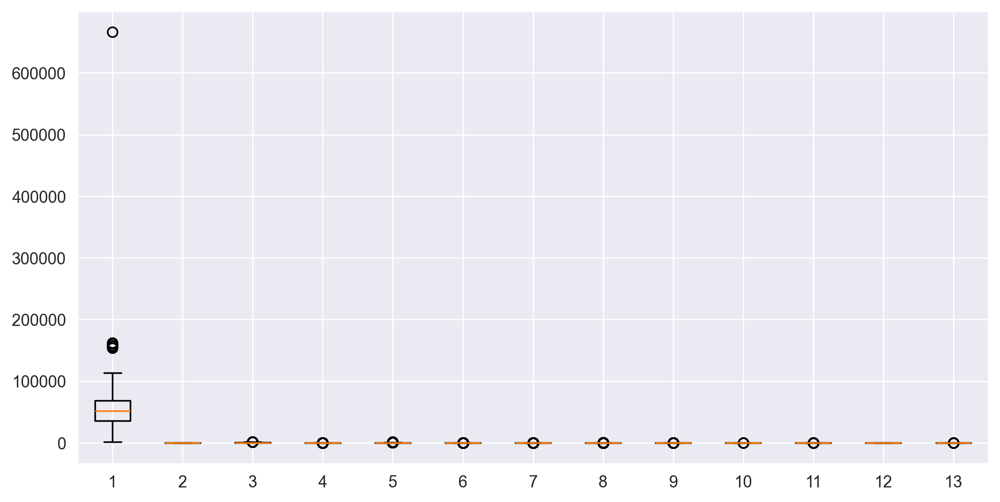

In [15]:
plt.boxplot(data[col])

#### Insights
- from boxplots we can see that Outliers presents in almost all columns.
- we need to replace them bu capping method

#### Outlier Removal from thr Four Columns

In [16]:
# removes Outliers from the column
def outlier_cap(df,column):
     """
    Removes outliers from the given column in the datafram.

    Parameters:
    - df: pandas DataFrame
    - column: str, the column for which we want to remove outliers
    """
    # iterate columns in the dataframe
    
     for index,row in df.iterrows():
        
        # defining 75th and 25th percentile
        h = df[column].quantile(0.75)
        l = df[column].quantile(0.25)
        
        # Calculation the Interquartile Range 
        IQR = h - l
        
        # maximum and minimum value to replace for a Outlier from a column
        upper_threshold = h + 1.5*IQR
        lower_threshold = l - 1.5*IQR
        
        # Replacing the Outliers using ifelse conditions
        if row[column] > upper_threshold:
            df.at[index, column] = upper_threshold
        elif row[column] < lower_threshold:
            df.at[index, column] = lower_threshold

In [17]:
# for i in col:
#    outlier_cap(data,i)

#### 4.1.2 Checking Correalation Between Features

In [18]:
col2 = ['ID', 'Year_Birth', 'Income', 'Kidhome',
       'Teenhome', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth']

In [19]:
data[col2].corr()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
ID,1.000000,0.000028,0.013036,0.002406,-0.002580,-0.046524,-0.022878,0.004600,-0.004437,-0.024475,-0.007642,-0.013438,-0.037166,-0.018924,-0.003440,-0.014927,-0.007446
Year_Birth,0.000028,1.000000,-0.160942,0.230176,-0.352111,-0.019871,-0.157773,-0.017917,-0.030872,-0.041625,-0.018133,-0.061818,-0.060846,-0.145040,-0.121275,-0.128272,0.121139
Income,0.013036,-0.160942,1.000000,-0.425176,0.019018,-0.003946,0.576789,0.428747,0.577802,0.437497,0.436162,0.321978,-0.082290,0.380550,0.586725,0.526489,-0.549824
Kidhome,0.002406,0.230176,-0.425176,1.000000,-0.036133,0.008827,-0.496297,-0.372581,-0.437129,-0.387644,-0.370673,-0.349595,0.221798,-0.361647,-0.502237,-0.499683,0.447846
Teenhome,-0.002580,-0.352111,0.019018,-0.036133,1.000000,0.016198,0.004846,-0.176764,-0.261160,-0.204187,-0.162475,-0.021725,0.387741,0.155500,-0.110769,0.050695,0.134884
Recency,-0.046524,-0.019871,-0.003946,0.008827,0.016198,1.000000,0.016064,-0.004306,0.023056,0.001079,0.022670,0.016693,-0.001098,-0.010726,0.025110,0.000799,-0.021445
MntWines,-0.022878,-0.157773,0.576789,-0.496297,0.004846,0.016064,1.000000,0.389637,0.562667,0.399753,0.386581,0.387516,0.010940,0.542265,0.635226,0.642100,-0.320653
MntFruits,0.004600,-0.017917,0.428747,-0.372581,-0.176764,-0.004306,0.389637,1.000000,0.543105,0.594804,0.567164,0.392995,-0.132114,0.296735,0.487917,0.461758,-0.418383
MntMeatProducts,-0.004437,-0.030872,0.577802,-0.437129,-0.261160,0.023056,0.562667,0.543105,1.000000,0.568402,0.523846,0.350609,-0.122415,0.293761,0.723827,0.479659,-0.539470
MntFishProducts,-0.024475,-0.041625,0.437497,-0.387644,-0.204187,0.001079,0.399753,0.594804,0.568402,1.000000,0.579870,0.422875,-0.139361,0.293681,0.534478,0.459855,-0.446003


<Axes: >

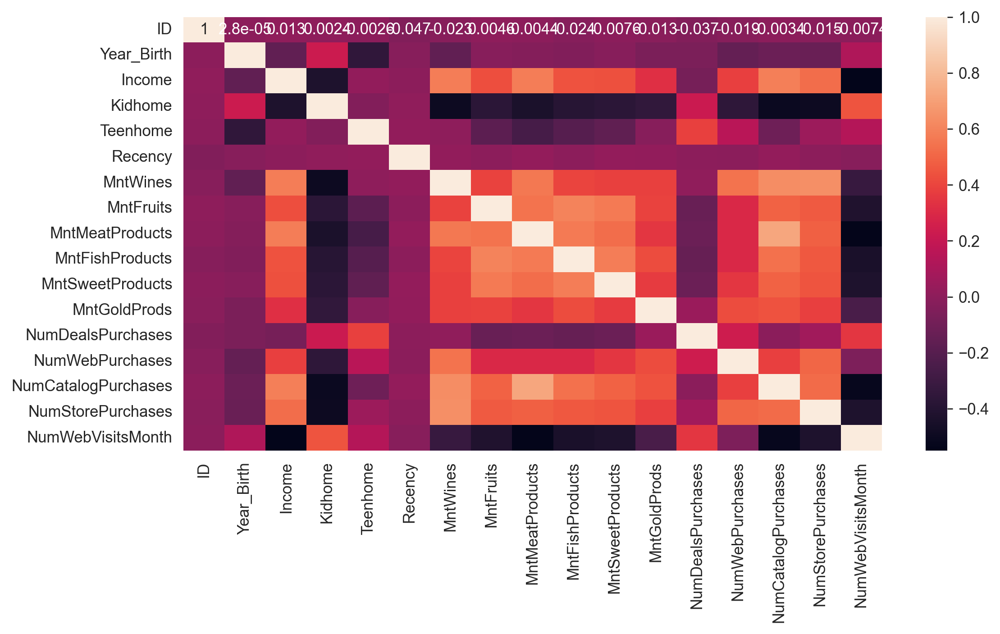

In [20]:
# Heatmap to visualize the relations
sns.heatmap(data[col2].corr(),annot = True)

#### Insights
- From corr function we can say that all the features are closely related to each other and some of them is correlated to 1

#### 4.1.3 Scatter plots

In [21]:
sns.pairplot(data = data[col2])

#### 4.1.4 Histogram and density plot

In [22]:
def density_plot(df):
    """
    Plot density plots for all columns in the DataFrame against the target column.

    Parameters:
    - df: pandas DataFrame
    """

    # Get all columns except the target column
    features = df.columns

    # Determine the number of rows and columns for subplots
    num_plots = len(features)
    num_cols = 2  
    num_rows = (num_plots - 1) // num_cols + 1

    # Create subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 5))

    # Flatten axes if necessary
    axes = axes.flatten()

    # Loop through each feature and plot scatter plot
    for i, feature in enumerate(features):
        ax = axes[i]
        sns.histplot(data=df, x=feature, kde=True, ax=ax)
        ax.set_title(f"{feature}")
        ax.set_xlabel(feature)

    plt.tight_layout()
    plt.show()

In [23]:
density_plot(data)

### 5. Univariate Analysis

- since ID column is a column creates for unique identification we can drop the colum

#### 5.1 Univarite Analysis on Year_Birth Column (Renamed as Age)

In [24]:
data.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


In [25]:
data.rename(columns = {'Year_Birth':'Age'},inplace = True)

In [26]:
data['Age'] = 2024 - data['Age']

In [27]:
data.head()

,ID,Age,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,67,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,70,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,59,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,40,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,43,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


<Axes: xlabel='Age', ylabel='Count'>

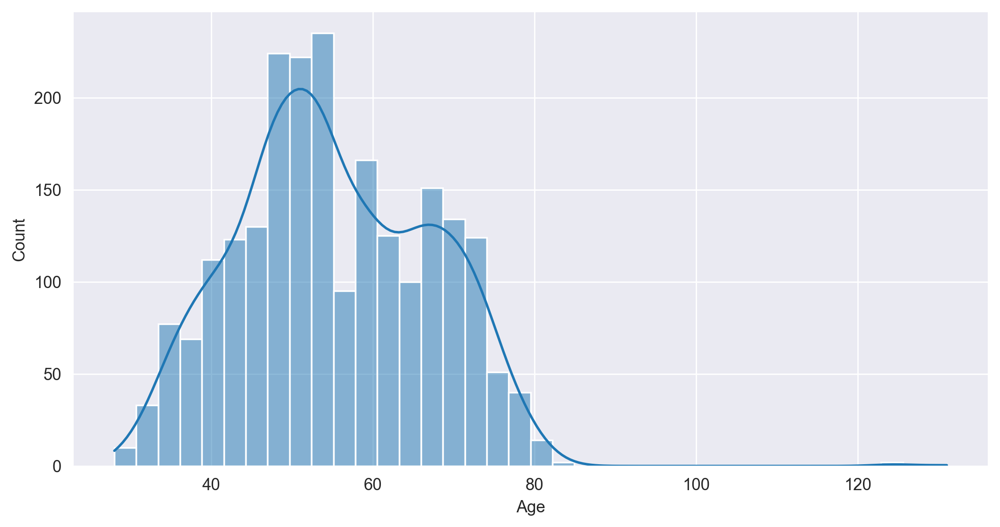

In [28]:
sns.histplot(data['Age'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204c70e0e50>,
 'caps': [<matplotlib.lines.Line2D at 0x204c70e1390>,
 'boxes': [<matplotlib.lines.Line2D at 0x204c70e0bb0>],
 'medians': [<matplotlib.lines.Line2D at 0x204c70e17b0>],
 'fliers': [<matplotlib.lines.Line2D at 0x204c70e1a50>],
 'means': []}

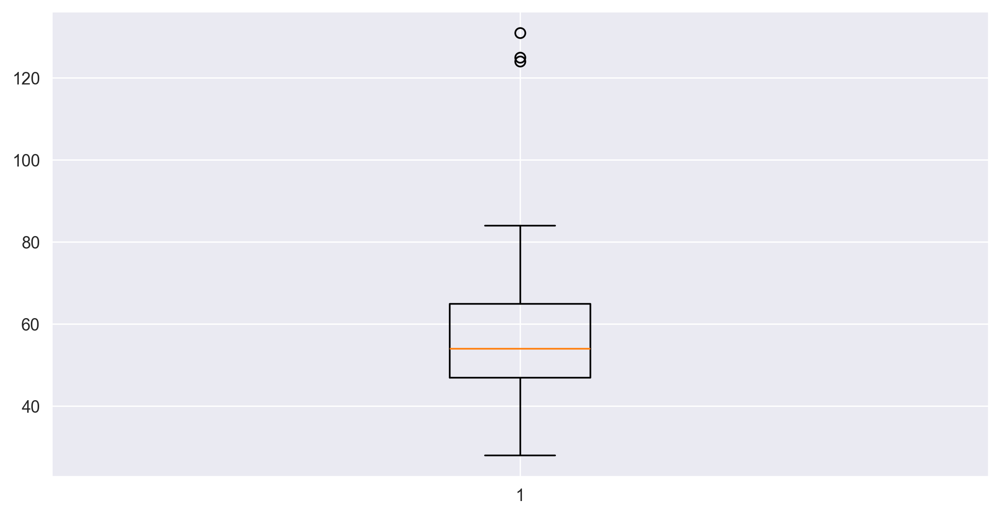

In [29]:
plt.boxplot(data['Age'])

In [30]:
outlier_cap(data,'Age')

- From kde plot we can say that most of the customer are of age 45 to 55
- Also the range of age of customers is between 15 to 120 which signifies the presence of outliers
- From box plot we can say that the column  have  outliers which is age above 120 which can be considered as outliers

#### 5.2 Univarite Analysis on Education column

In [31]:
# plot count plot for the Education column
data['Education'].value_counts()

Education
Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: count, dtype: int64

<Axes: xlabel='Education', ylabel='count'>

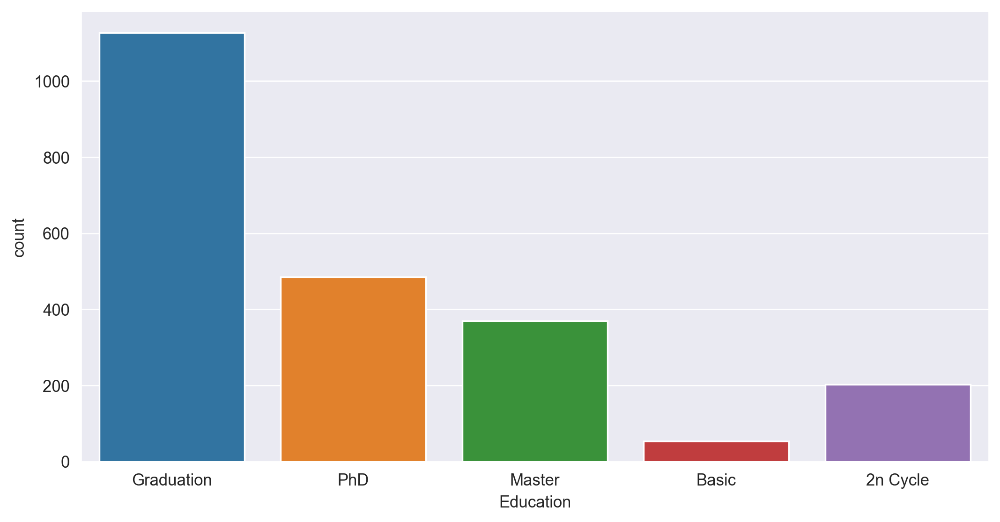

In [32]:
sns.countplot(x ='Education', data =data)

- from the bargraph it can be said that the most of the customers are having education as Gradution and least of them have basic education

#### 5.3 Univarite Analysis on Marital_Status column

In [33]:
# plot count plot for the Education column
data['Marital_Status'].value_counts()

Marital_Status
Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
Absurd        2
YOLO          2
Name: count, dtype: int64

<Axes: xlabel='Marital_Status', ylabel='count'>

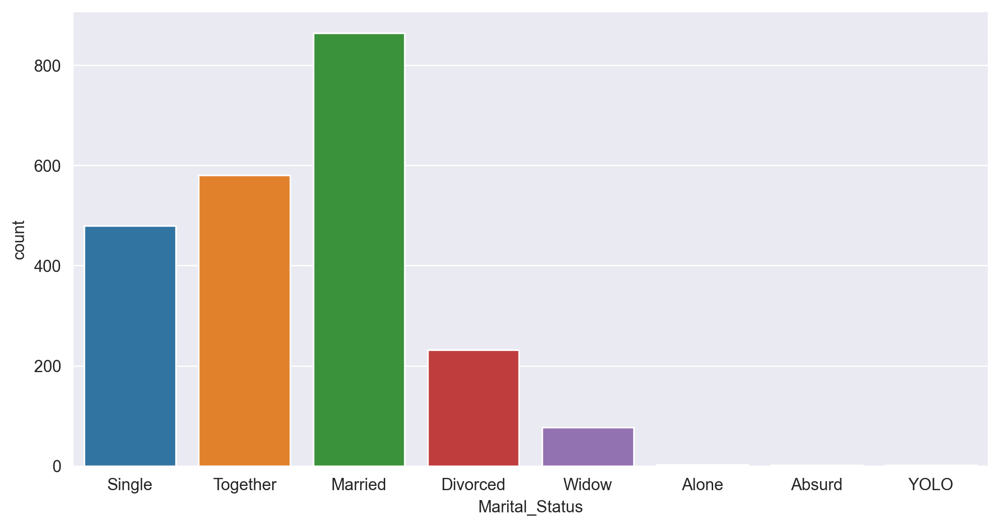

In [34]:
sns.countplot(x ='Marital_Status', data =data)

- The married customer base is more than the other catagories 

#### 5.4 Univarite Analysis on Income column

<Axes: xlabel='Income', ylabel='Count'>

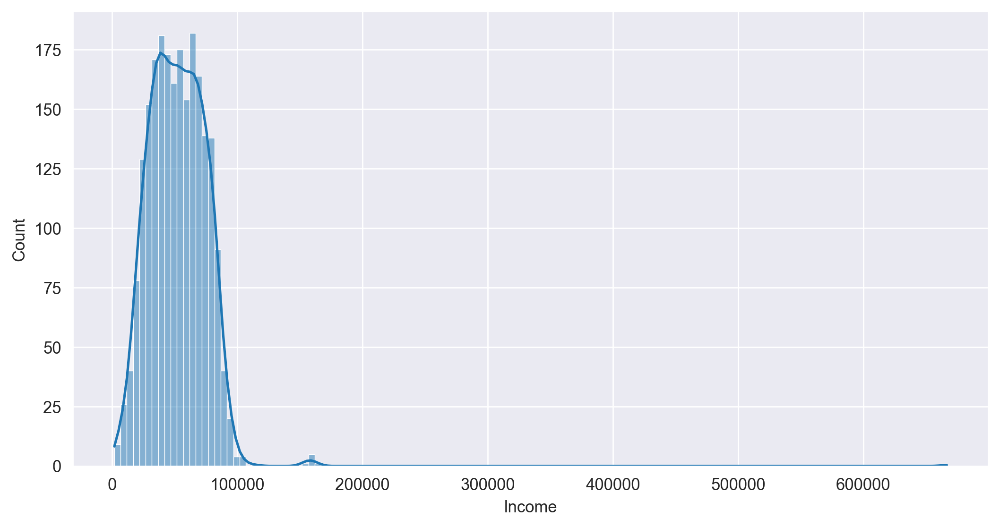

In [35]:
sns.histplot(data['Income'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204c8f58310>,
 'caps': [<matplotlib.lines.Line2D at 0x204c8f58850>,
 'boxes': [<matplotlib.lines.Line2D at 0x204c8f58070>],
 'medians': [<matplotlib.lines.Line2D at 0x204c8f58d90>],
 'fliers': [<matplotlib.lines.Line2D at 0x204c8f59030>],
 'means': []}

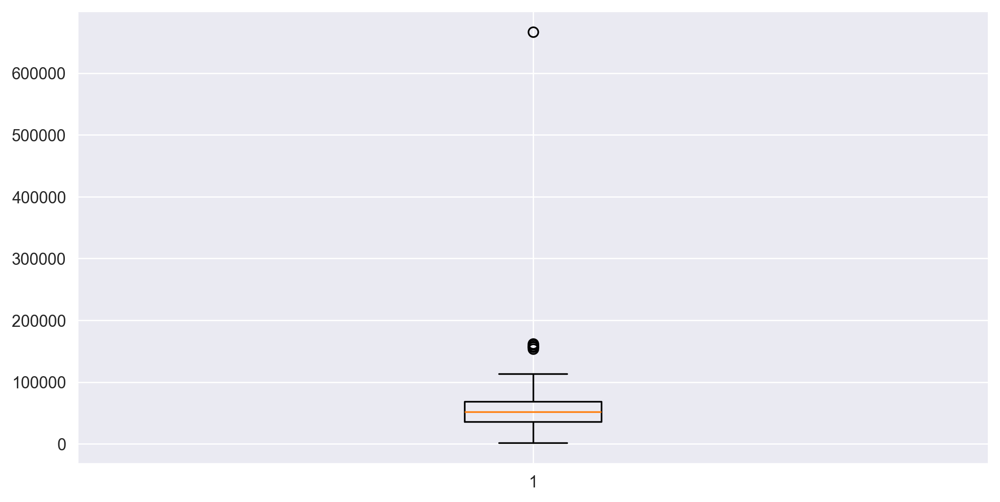

In [36]:
plt.boxplot(data['Income'])

In [37]:
outlier_cap(data,'Income')

#### 5.5 Univarite Analysis on Kidhome and Teenhome column ( chenge in to Children column)
- as the both columns include number of children at home we are combining the both column to form a new column called Children

In [38]:
data.head()

,ID,Age,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,67,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,70,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,59,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,40,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,43,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


In [39]:
data['Children'] = data['Kidhome'] + data['Teenhome']

In [40]:
data = data.drop(columns = ['Kidhome','Teenhome'])

In [41]:
data['Children'].value_counts()

Children
1    1128
0     638
2     421
3      53
Name: count, dtype: int64

<Axes: xlabel='Children', ylabel='count'>

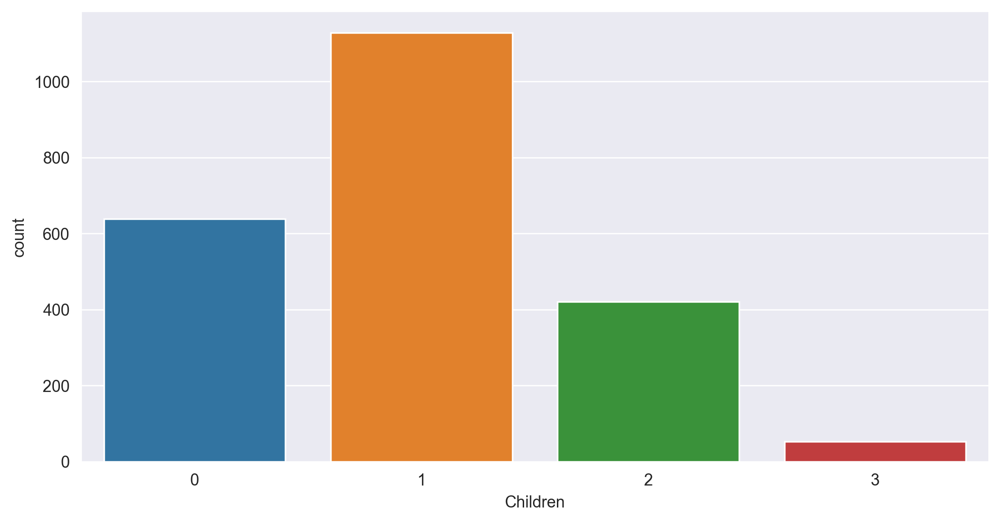

In [42]:
sns.countplot(x ='Children', data =data)

- Most of the customer 1 child at home 

#### 5.6 Univarite Analysis on Dt_Customer column 
- From this column we can form a new column like for how much years is the customer is with company

In [43]:
# Calculate the years for which customer is with company (in years)
current_date = datetime.now()
data['Years_with_Company'] = (current_date - data['Dt_Customer']).dt.days / 365

# Round the years to two decimal places if needed
data['Years_with_Company'] = data['Years_with_Company'].round()

In [44]:
data = data.drop(columns = ['Dt_Customer'])

<Axes: xlabel='Years_with_Company', ylabel='Count'>

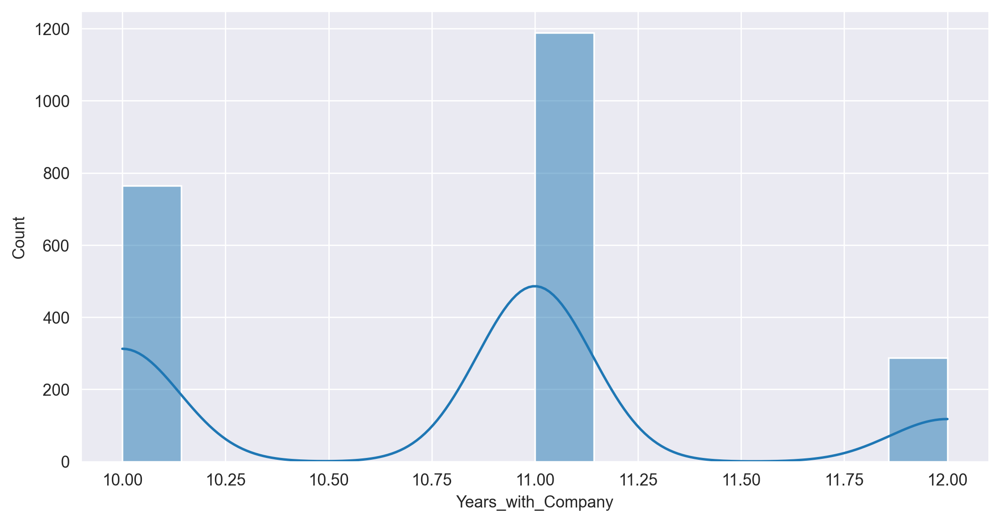

In [45]:
sns.histplot(data['Years_with_Company'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204c99cbb20>,
 'caps': [<matplotlib.lines.Line2D at 0x204c99f80a0>,
 'boxes': [<matplotlib.lines.Line2D at 0x204c99cb880>],
 'medians': [<matplotlib.lines.Line2D at 0x204c99f85e0>],
 'fliers': [<matplotlib.lines.Line2D at 0x204c99f8880>],
 'means': []}

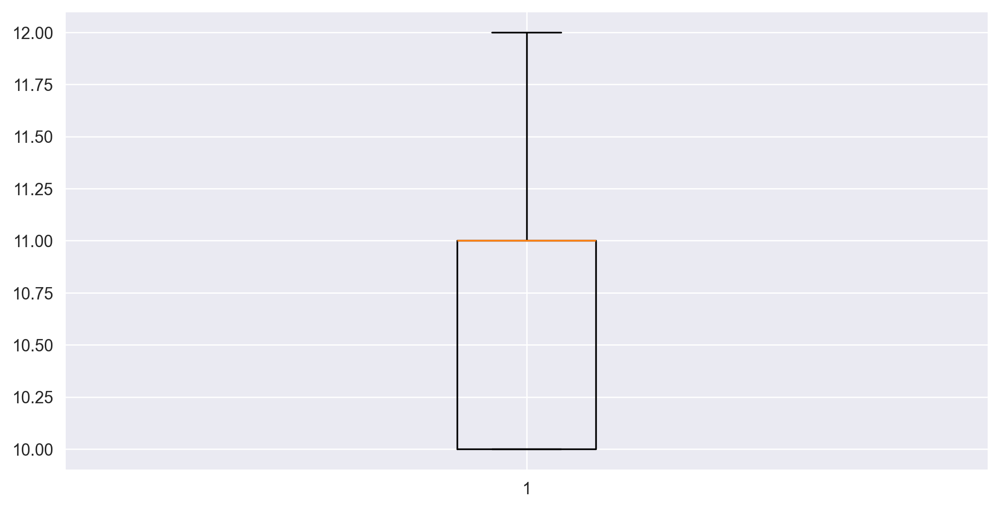

In [46]:
plt.boxplot(data['Years_with_Company'])

#### 5.7 Univaritate analysis on Recency column

<Axes: xlabel='Recency', ylabel='Count'>

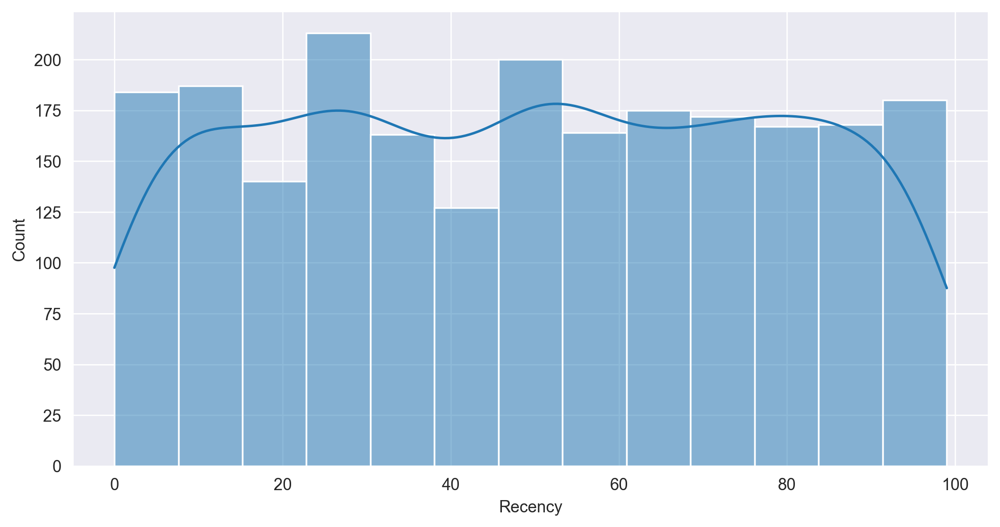

In [47]:
sns.histplot(data['Recency'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cae18ac0>,
 'caps': [<matplotlib.lines.Line2D at 0x204cae19000>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cae18820>],
 'medians': [<matplotlib.lines.Line2D at 0x204cae19540>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cae197e0>],
 'means': []}

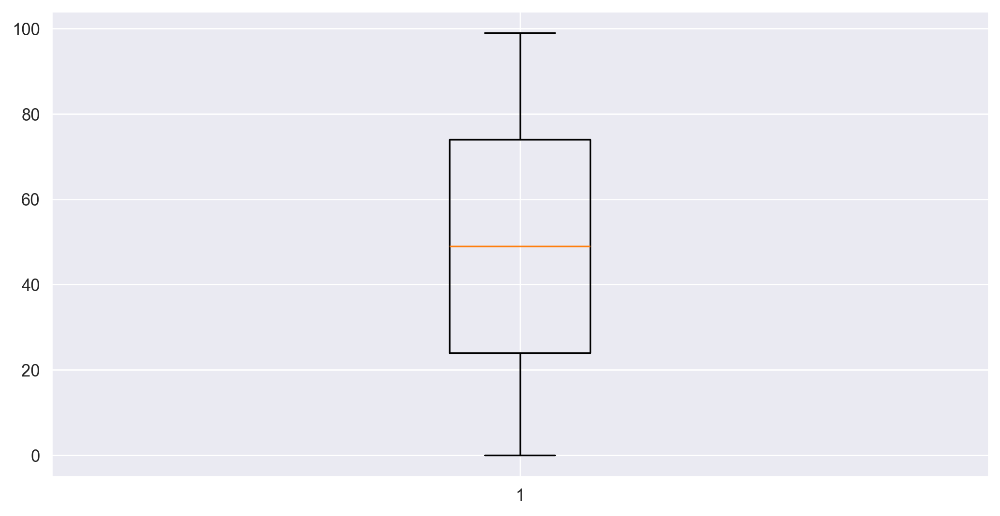

In [48]:
plt.boxplot(data['Recency'])

-  The range of recency varied between 0 to 99

#### 5.8 Univaritate analysis on MntWines column¶

In [49]:
pd.set_option('display.max_columns',None)
data.head()

,ID,Age,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Children,Years_with_Company
0,5524,67,Graduation,Single,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1,0,12.0
1,2174,70,Graduation,Single,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0,2,10.0
2,4141,59,Graduation,Together,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0,0,11.0
3,6182,40,Graduation,Together,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0,1,10.0
4,5324,43,PhD,Married,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0,1,10.0


<Axes: xlabel='MntWines', ylabel='Count'>

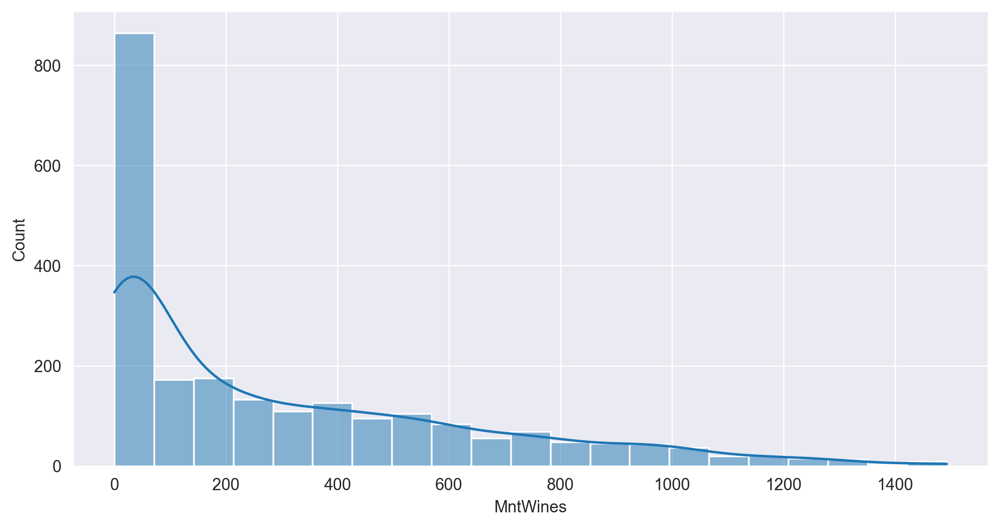

In [50]:
sns.histplot(data['MntWines'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204caf283d0>,
 'caps': [<matplotlib.lines.Line2D at 0x204caf28910>,
 'boxes': [<matplotlib.lines.Line2D at 0x204caf28130>],
 'medians': [<matplotlib.lines.Line2D at 0x204caf28d30>],
 'fliers': [<matplotlib.lines.Line2D at 0x204caf28fd0>],
 'means': []}

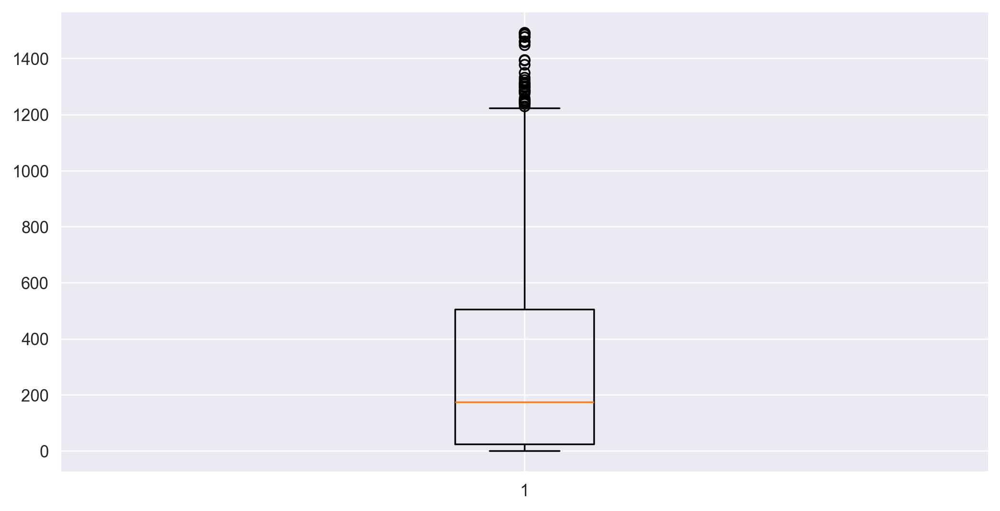

In [51]:
plt.boxplot(data['MntWines'])

In [52]:
outlier_cap(data,'MntWines')

#### 5.9 Univariate analysis on MntFruits column

<Axes: xlabel='MntFruits', ylabel='Count'>

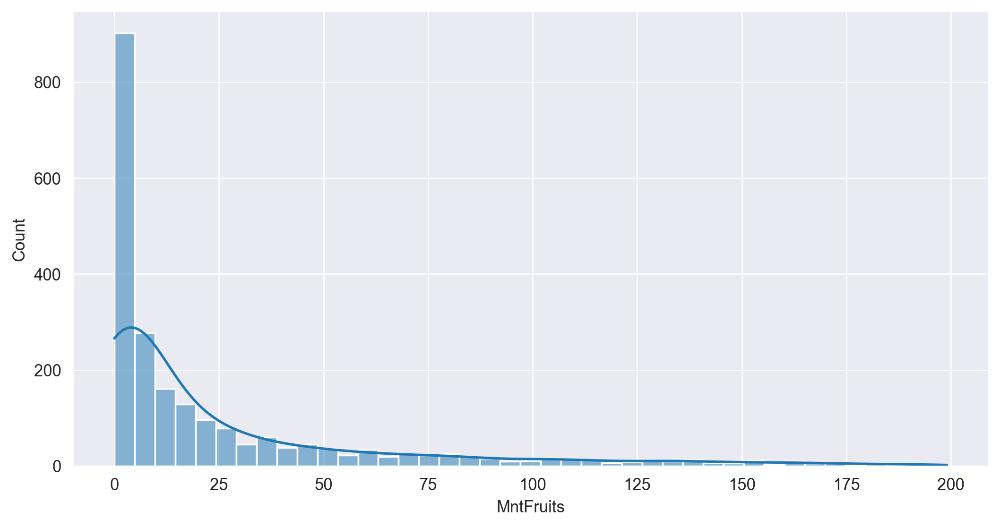

In [53]:
sns.histplot(data['MntFruits'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cb8bff40>,
 'caps': [<matplotlib.lines.Line2D at 0x204cb8f04c0>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cb8bfca0>],
 'medians': [<matplotlib.lines.Line2D at 0x204cb8f0a00>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cb8f0ca0>],
 'means': []}

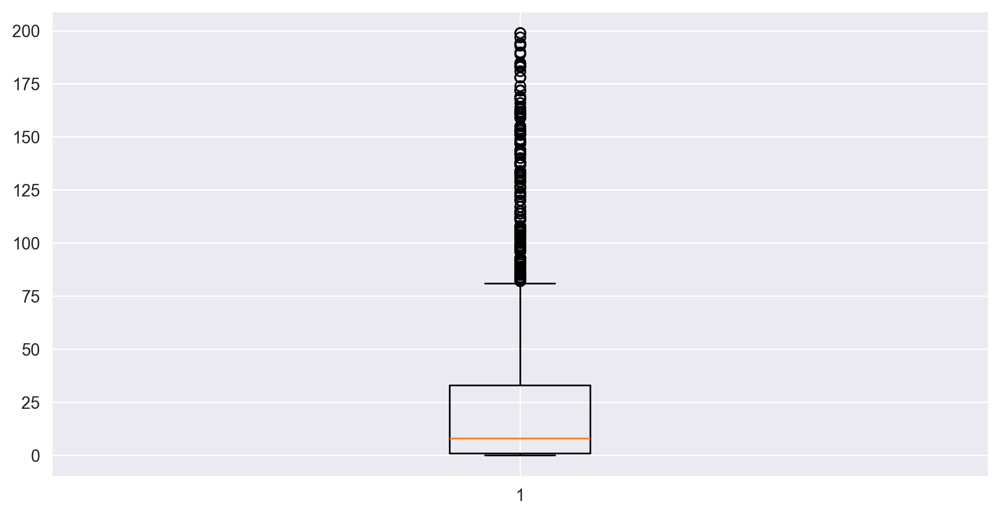

In [54]:
plt.boxplot(data['MntFruits'])

In [55]:
outlier_cap(data,'MntFruits')

#### 5.10 Univariate analysis on MntMeatProducts column

<Axes: xlabel='MntMeatProducts', ylabel='Count'>

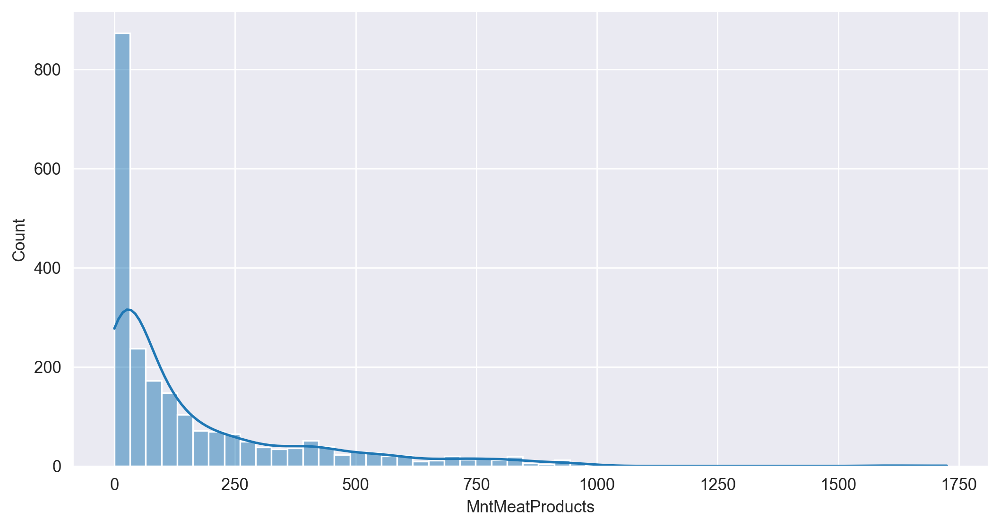

In [56]:
sns.histplot(data['MntMeatProducts'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cc358cd0>,
 'caps': [<matplotlib.lines.Line2D at 0x204cc359210>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cc358a30>],
 'medians': [<matplotlib.lines.Line2D at 0x204cc359750>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cc3599f0>],
 'means': []}

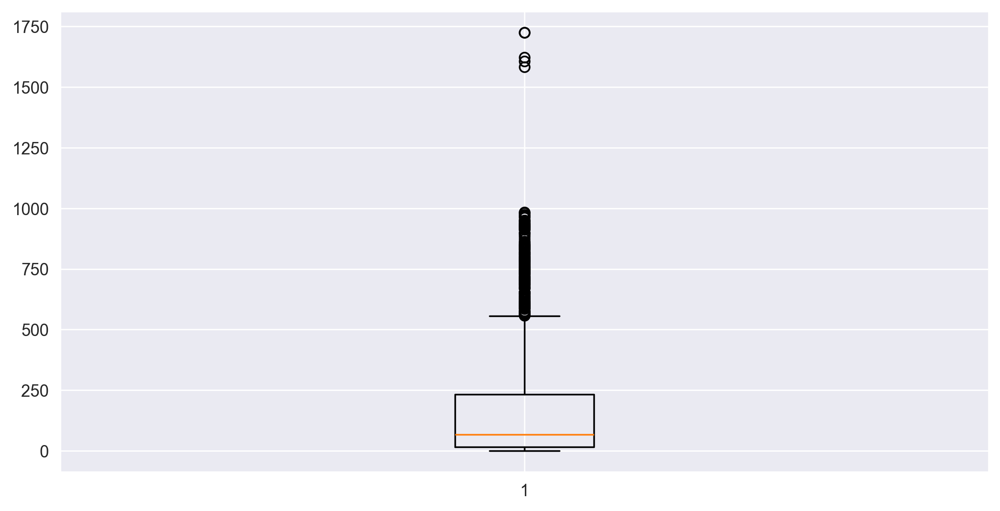

In [57]:
plt.boxplot(data['MntMeatProducts'])

In [58]:
outlier_cap(data,'MntFruits')

#### 5.11 Univariate analysis on MntFishProducts column

<Axes: xlabel='MntFishProducts', ylabel='Count'>

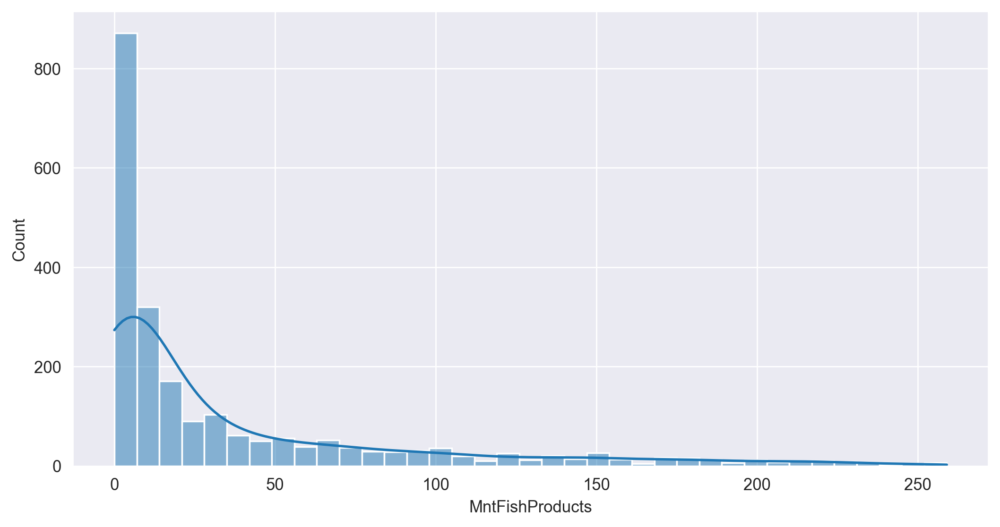

In [59]:
sns.histplot(data['MntFishProducts'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cf2c6e00>,
 'caps': [<matplotlib.lines.Line2D at 0x204cf2c7220>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cf2c6b60>],
 'medians': [<matplotlib.lines.Line2D at 0x204cf2c7790>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cf2c7a30>],
 'means': []}

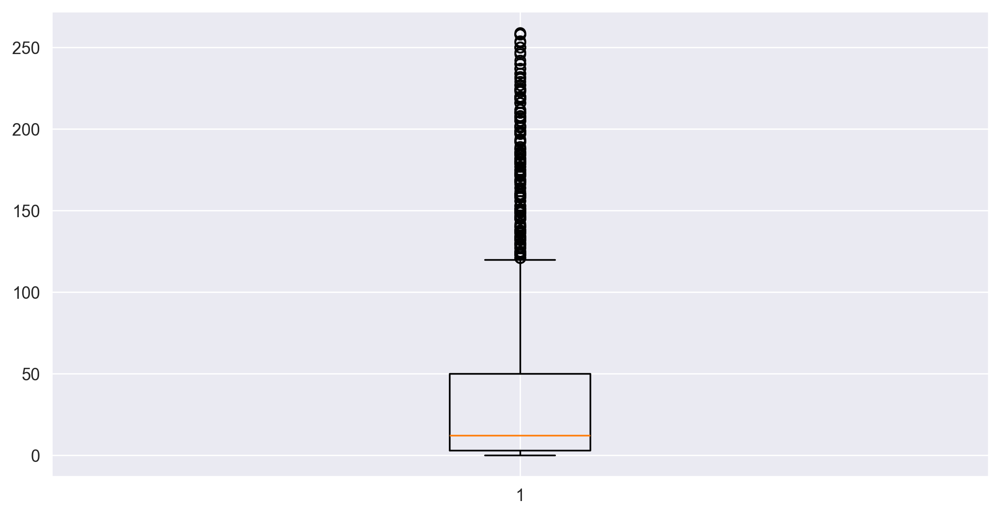

In [60]:
plt.boxplot(data['MntFishProducts'])

In [61]:
outlier_cap(data,'MntFishProducts')

#### 5.12 Univariate analysis on MntSweetProducts column

<Axes: xlabel='MntSweetProducts', ylabel='Count'>

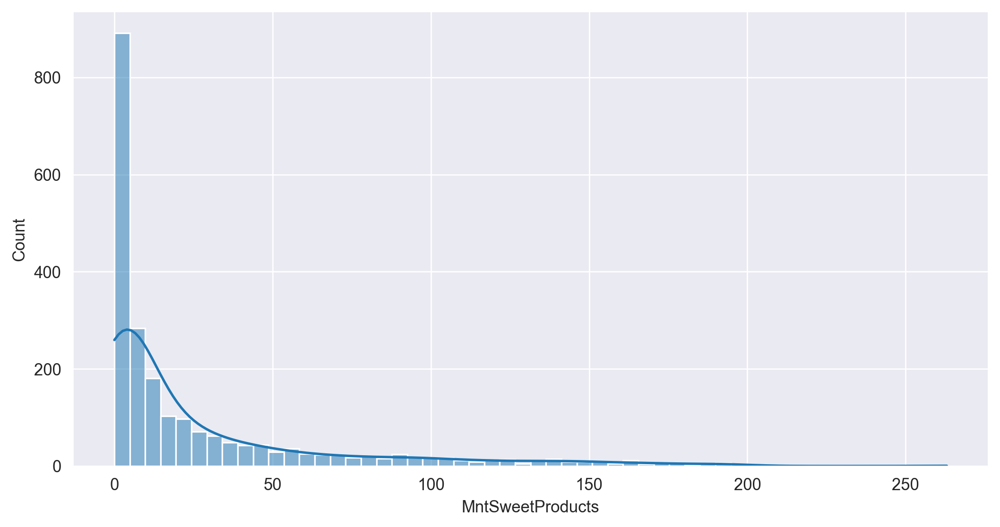

In [62]:
sns.histplot(data['MntSweetProducts'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cf4194b0>,
 'caps': [<matplotlib.lines.Line2D at 0x204cf4180a0>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cf419210>],
 'medians': [<matplotlib.lines.Line2D at 0x204cf419e10>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cf41a0b0>],
 'means': []}

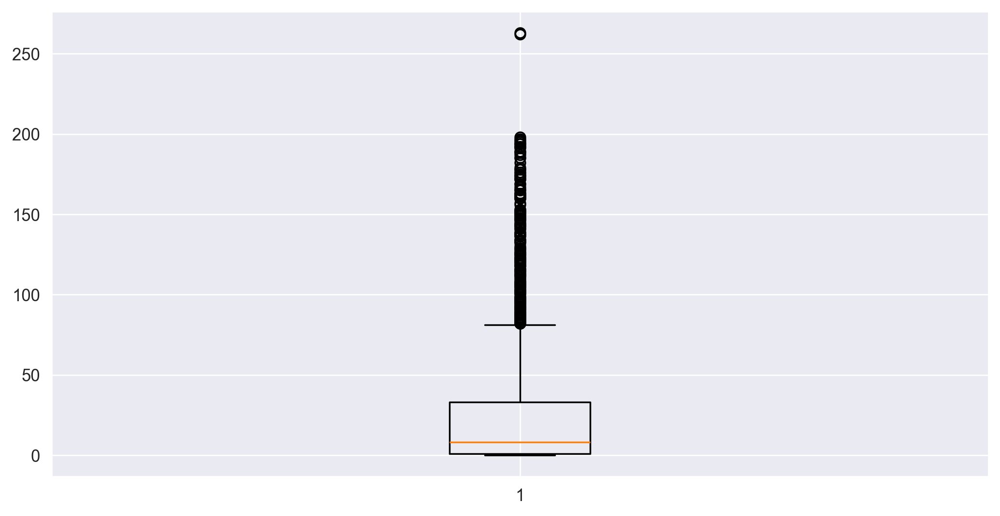

In [63]:
plt.boxplot(data['MntSweetProducts'])

In [64]:
outlier_cap(data,'MntSweetProducts')

#### 5.13 Univariate analysis on MntGoldProds column

<Axes: xlabel='MntGoldProds', ylabel='Count'>

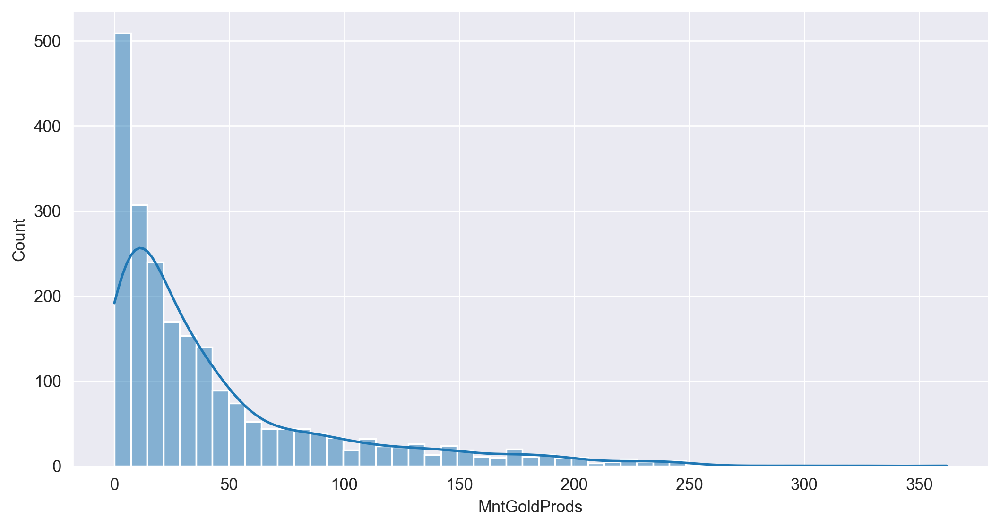

In [65]:
sns.histplot(data['MntGoldProds'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cf569870>,
 'caps': [<matplotlib.lines.Line2D at 0x204cf569db0>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cf5695d0>],
 'medians': [<matplotlib.lines.Line2D at 0x204cf56a2f0>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cf56a590>],
 'means': []}

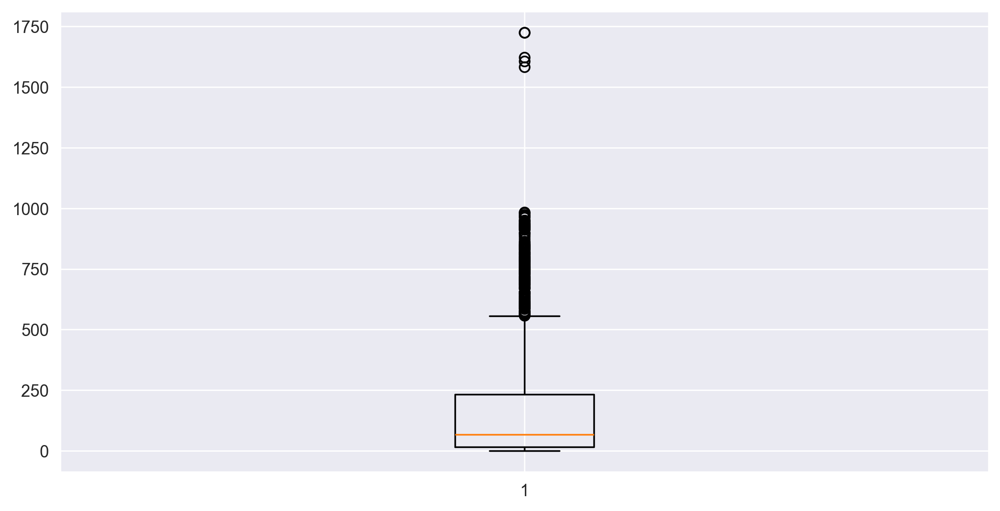

In [66]:
plt.boxplot(data['MntMeatProducts'])

In [67]:
outlier_cap(data,'MntMeatProducts')

#### 5.14 Univariate analysis on NumDealsPurchases column

<Axes: xlabel='NumDealsPurchases', ylabel='Count'>

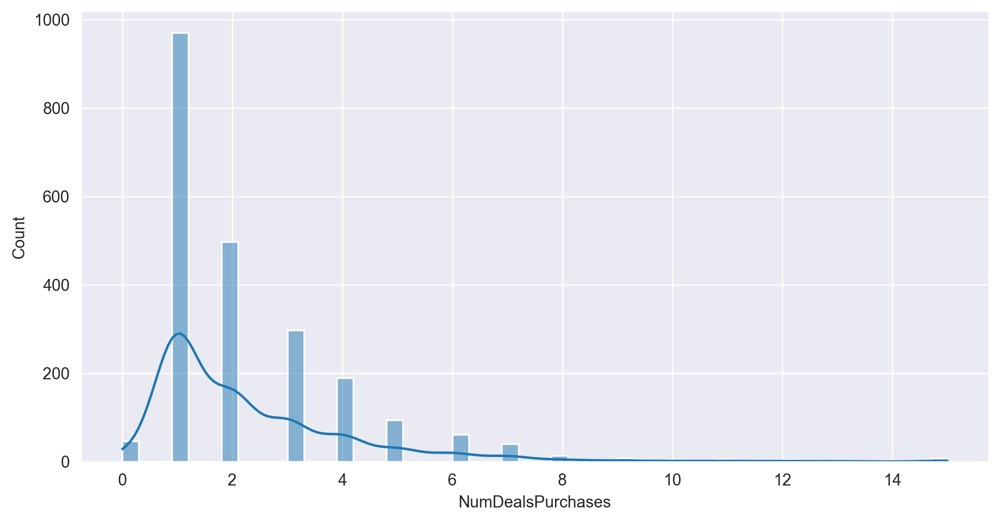

In [68]:
sns.histplot(data['NumDealsPurchases'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cf6b6020>,
 'caps': [<matplotlib.lines.Line2D at 0x204cf6b6560>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cf6b5d80>],
 'medians': [<matplotlib.lines.Line2D at 0x204cf6b6aa0>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cf6b6d40>],
 'means': []}

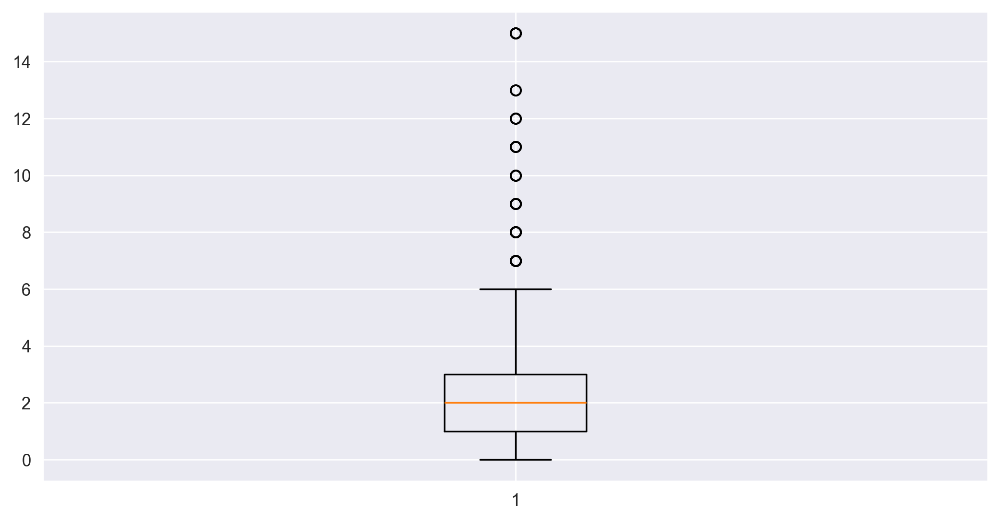

In [69]:
plt.boxplot(data['NumDealsPurchases'])

In [70]:
outlier_cap(data,'NumDealsPurchases')

#### 5.15 Univariate analysis on NumWebPurchases column

<Axes: xlabel='NumWebPurchases', ylabel='Count'>

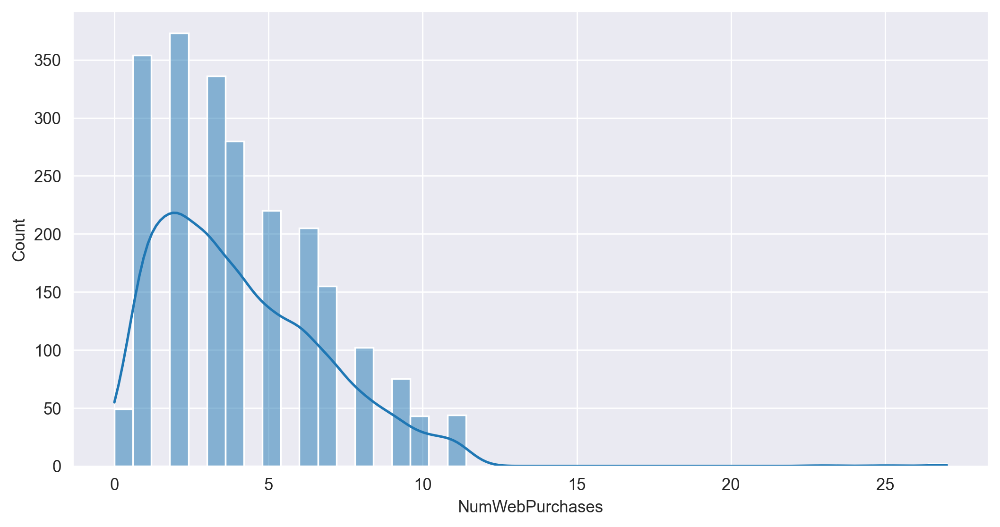

In [71]:
sns.histplot(data['NumWebPurchases'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cf7fe3b0>,
 'caps': [<matplotlib.lines.Line2D at 0x204cf7fe8f0>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cf7fe110>],
 'medians': [<matplotlib.lines.Line2D at 0x204cf7fee30>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cf7ff0d0>],
 'means': []}

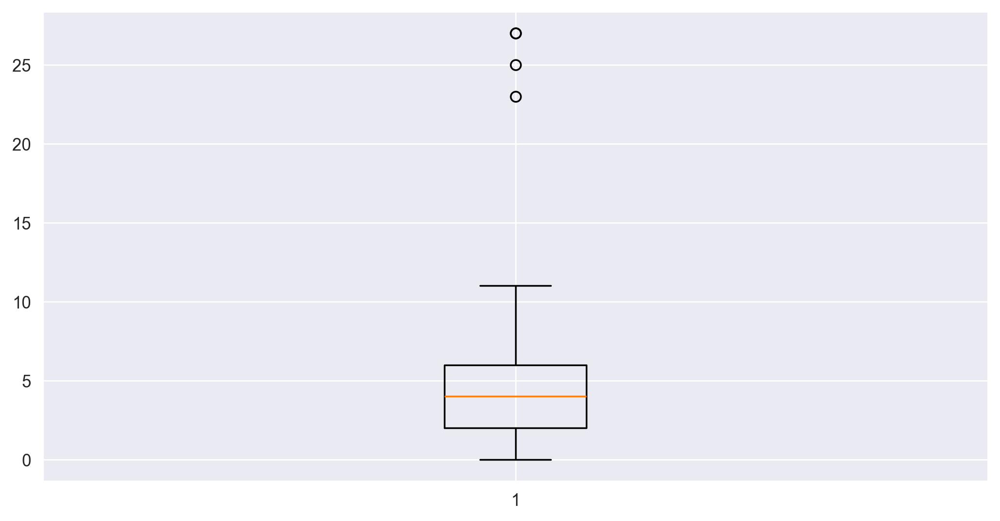

In [72]:
plt.boxplot(data['NumWebPurchases'])

In [73]:
outlier_cap(data,'NumWebPurchases')

#### 5.16 Univariate analysis on NumCatalogPurchases column

<Axes: xlabel='NumCatalogPurchases', ylabel='Count'>

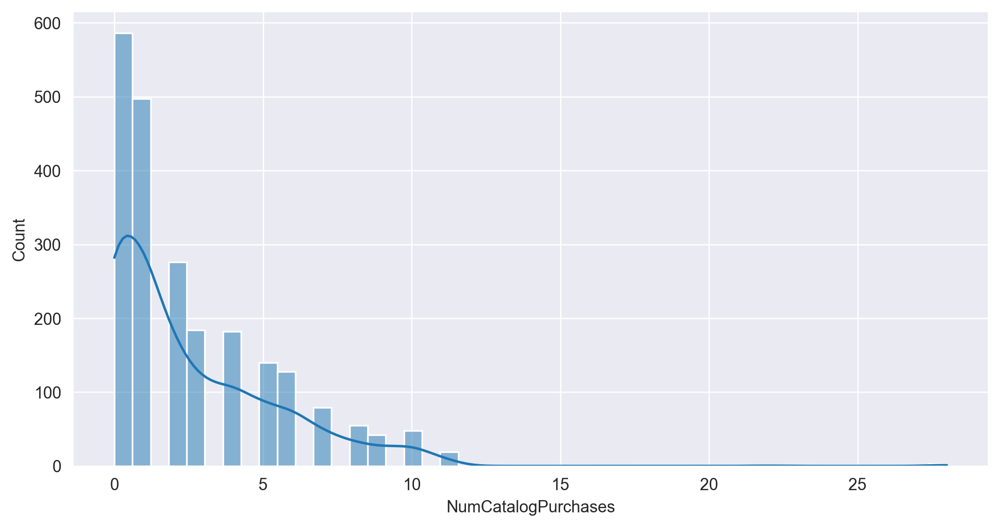

In [74]:
sns.histplot(data['NumCatalogPurchases'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204cf949450>,
 'caps': [<matplotlib.lines.Line2D at 0x204cf949900>,
 'boxes': [<matplotlib.lines.Line2D at 0x204cf9491b0>],
 'medians': [<matplotlib.lines.Line2D at 0x204cf949e40>],
 'fliers': [<matplotlib.lines.Line2D at 0x204cf94a0e0>],
 'means': []}

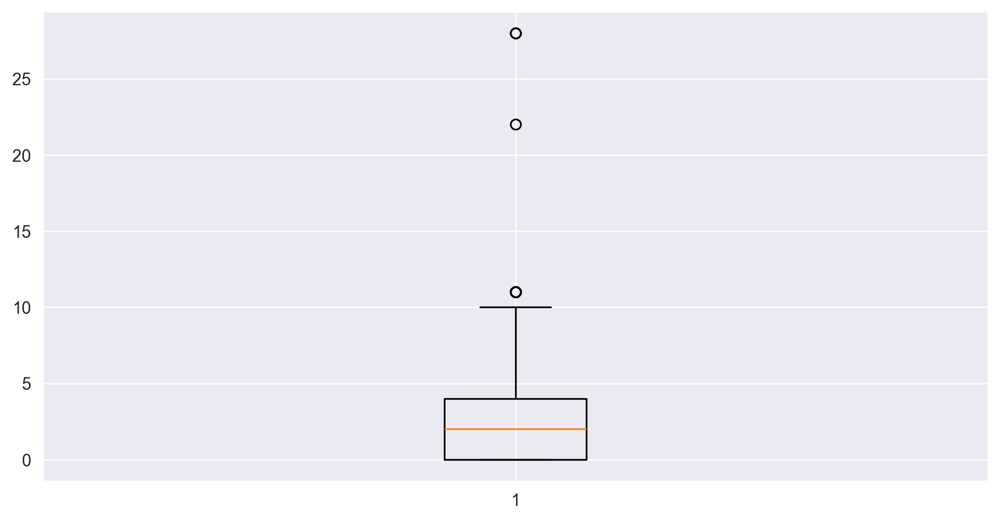

In [75]:
plt.boxplot(data['NumCatalogPurchases'])

In [76]:
outlier_cap(data,'NumCatalogPurchases')

#### 5.17 Univariate analysis on NumStorePurchases column

<Axes: xlabel='NumStorePurchases', ylabel='Count'>

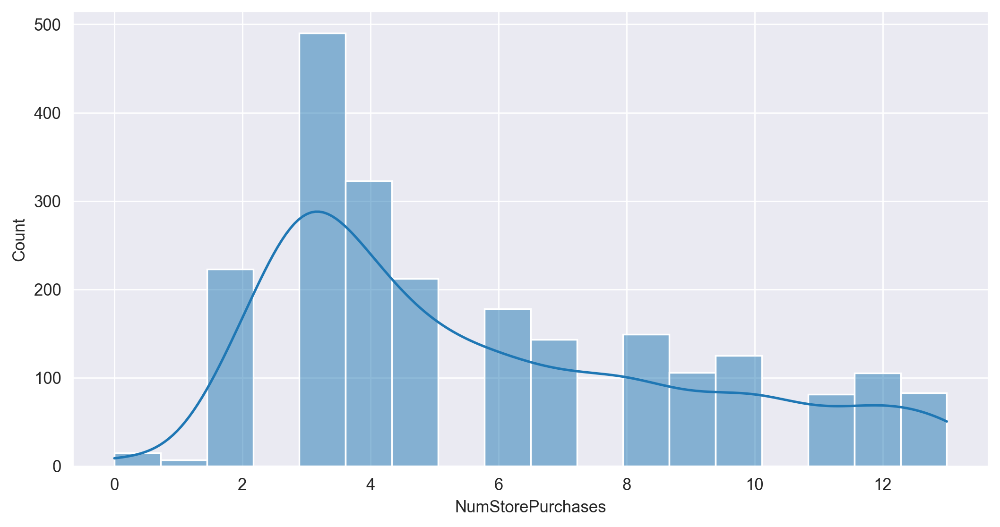

In [77]:
sns.histplot(data['NumStorePurchases'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204d1bd0ee0>,
 'caps': [<matplotlib.lines.Line2D at 0x204d1bd1420>,
 'boxes': [<matplotlib.lines.Line2D at 0x204d1bd0c40>],
 'medians': [<matplotlib.lines.Line2D at 0x204d1bd1960>],
 'fliers': [<matplotlib.lines.Line2D at 0x204d1bd1c00>],
 'means': []}

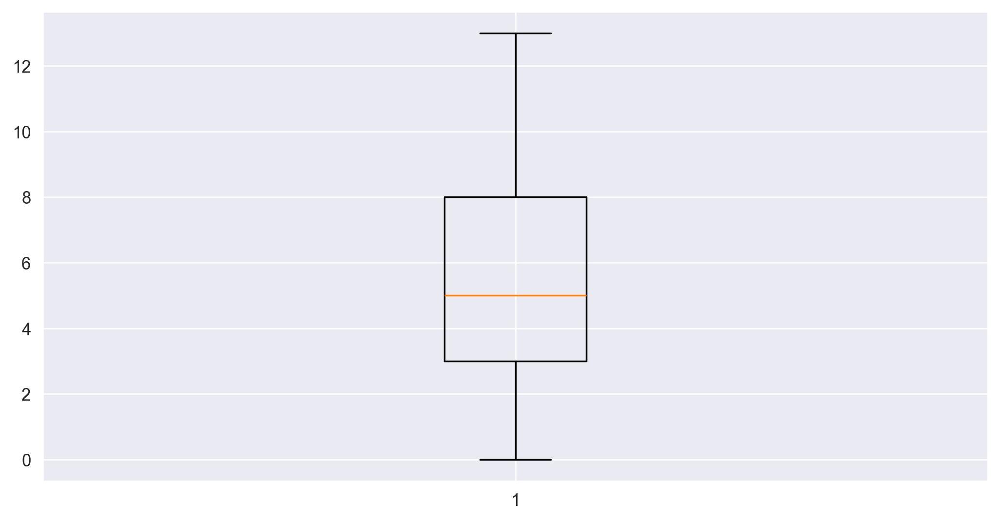

In [78]:
plt.boxplot(data['NumStorePurchases'])

In [79]:
outlier_cap(data,'NumStorePurchases')

#### 5.18 Univariate analysis on NumWebVisitsMonth column

<Axes: xlabel='NumWebVisitsMonth', ylabel='Count'>

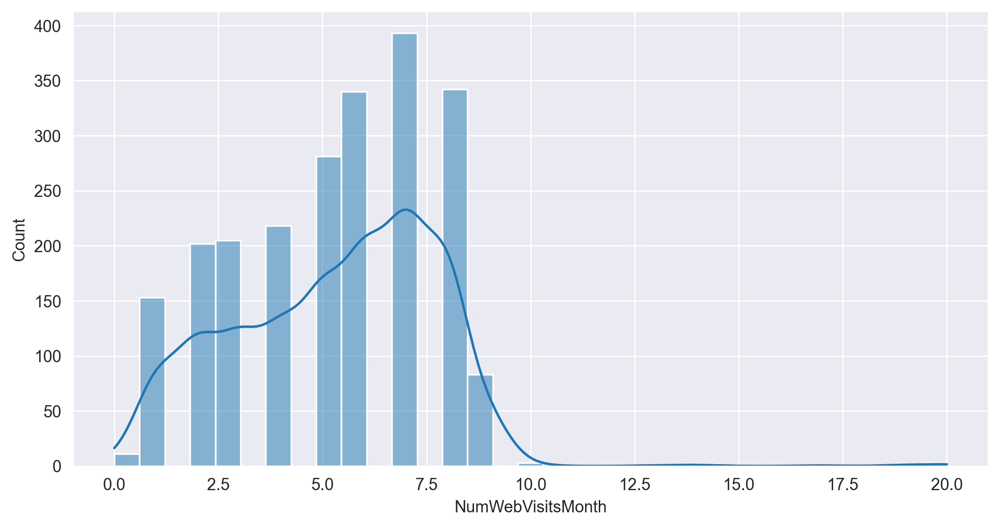

In [80]:
sns.histplot(data['NumWebVisitsMonth'],kde=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x204d1d18490>,
 'caps': [<matplotlib.lines.Line2D at 0x204d1d189d0>,
 'boxes': [<matplotlib.lines.Line2D at 0x204d1d181f0>],
 'medians': [<matplotlib.lines.Line2D at 0x204d1d18f10>],
 'fliers': [<matplotlib.lines.Line2D at 0x204d1d191b0>],
 'means': []}

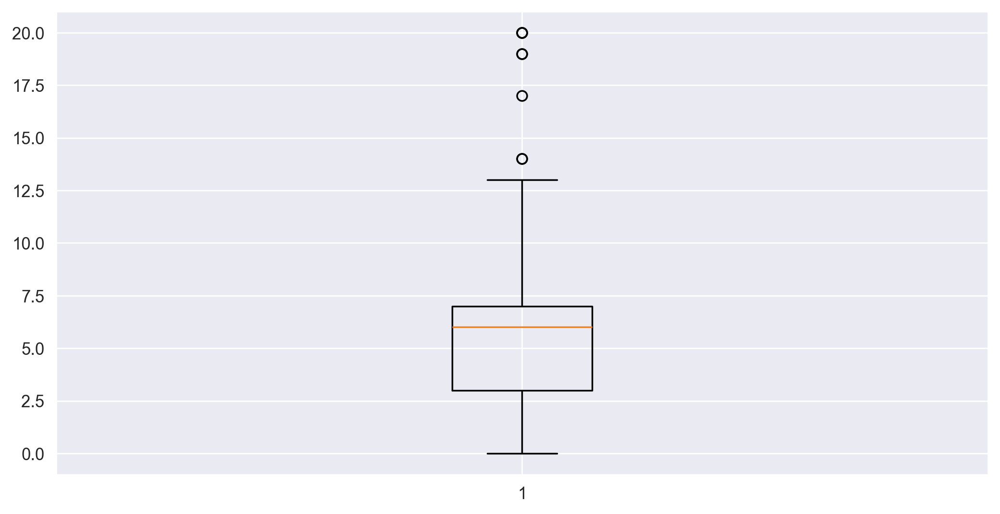

In [81]:
plt.boxplot(data['NumWebVisitsMonth'])

In [82]:
outlier_cap(data,'NumWebVisitsMonth')

#### 5.19 Univariate analysis on AcceptedCmp3 column

In [83]:
data['AcceptedCmp3'].value_counts()

AcceptedCmp3
0    2077
1     163
Name: count, dtype: int64

<Axes: xlabel='AcceptedCmp3', ylabel='count'>

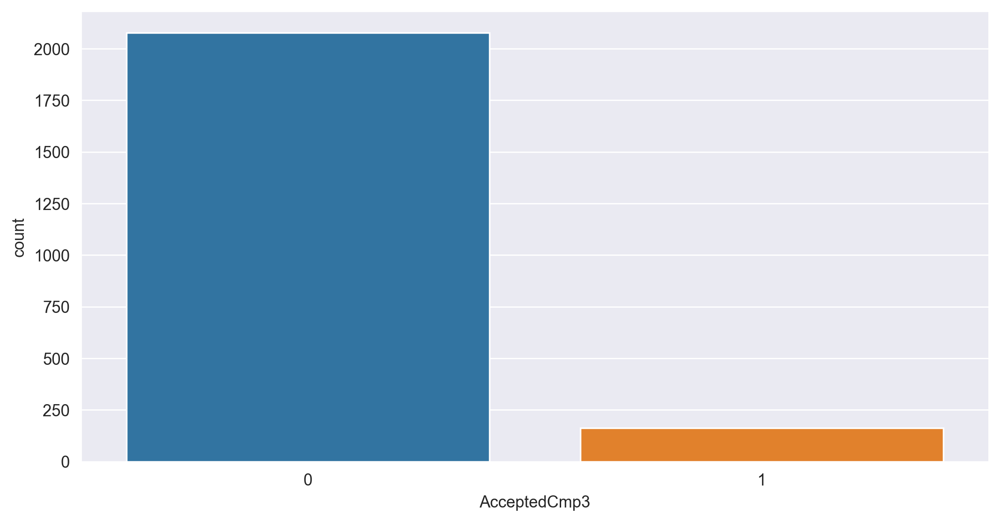

In [84]:
sns.countplot(x ='AcceptedCmp3', data =data)

#### 5.20 Univariate analysis on AcceptedCmp4 column

In [85]:
data['AcceptedCmp4'].value_counts()

AcceptedCmp4
0    2073
1     167
Name: count, dtype: int64

<Axes: xlabel='AcceptedCmp4', ylabel='count'>

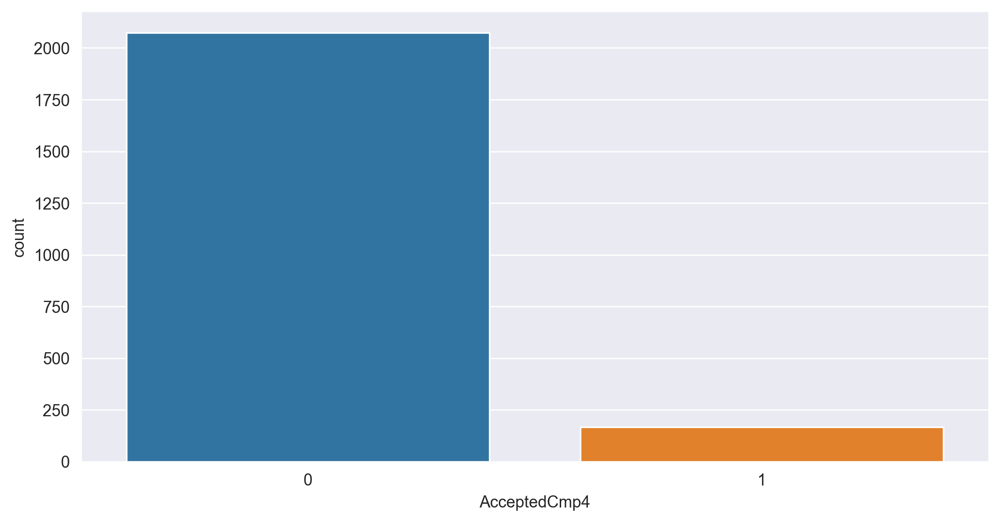

In [86]:
sns.countplot(x ='AcceptedCmp4', data =data)

#### 5.21 Univariate analysis on AcceptedCmp5 column

In [87]:
data['AcceptedCmp5'].value_counts()

AcceptedCmp5
0    2077
1     163
Name: count, dtype: int64

<Axes: xlabel='AcceptedCmp5', ylabel='count'>

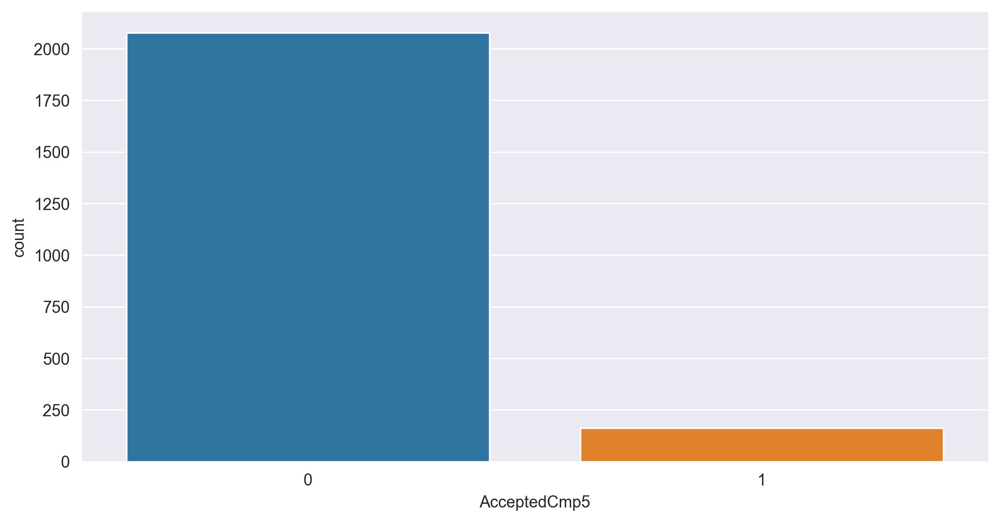

In [88]:
sns.countplot(x ='AcceptedCmp5', data =data)

- Dropping this column as this column only have 0 values as observarions 

#### 5.22 Univariate analysis on AcceptedCmp1 column

In [89]:
data['AcceptedCmp1'].value_counts()

AcceptedCmp1
0    2096
1     144
Name: count, dtype: int64

<Axes: xlabel='AcceptedCmp1', ylabel='count'>

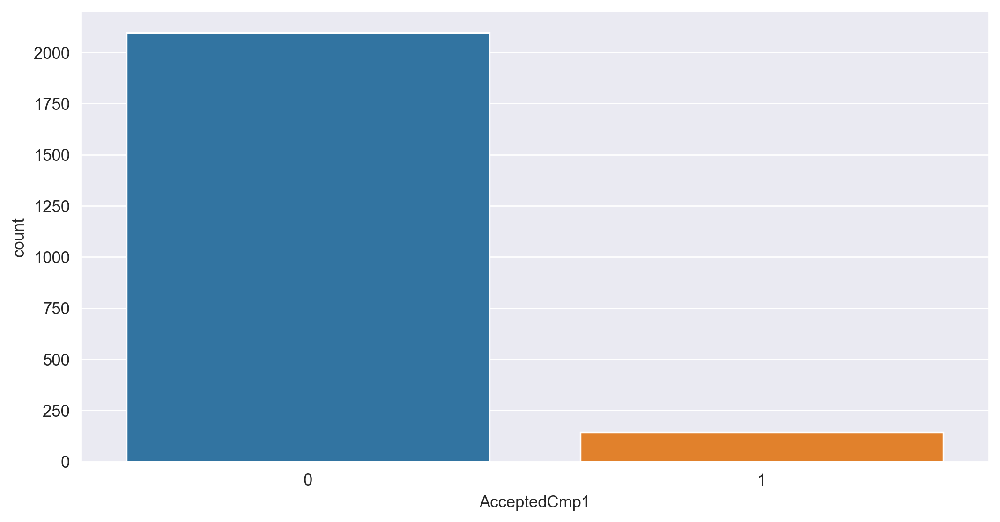

In [90]:
sns.countplot(x ='AcceptedCmp1', data =data)

#### 5.23 Univariate analysis on AcceptedCmp2 column

In [91]:
data['AcceptedCmp2'].value_counts()

AcceptedCmp2
0    2210
1      30
Name: count, dtype: int64

<Axes: xlabel='AcceptedCmp2', ylabel='count'>

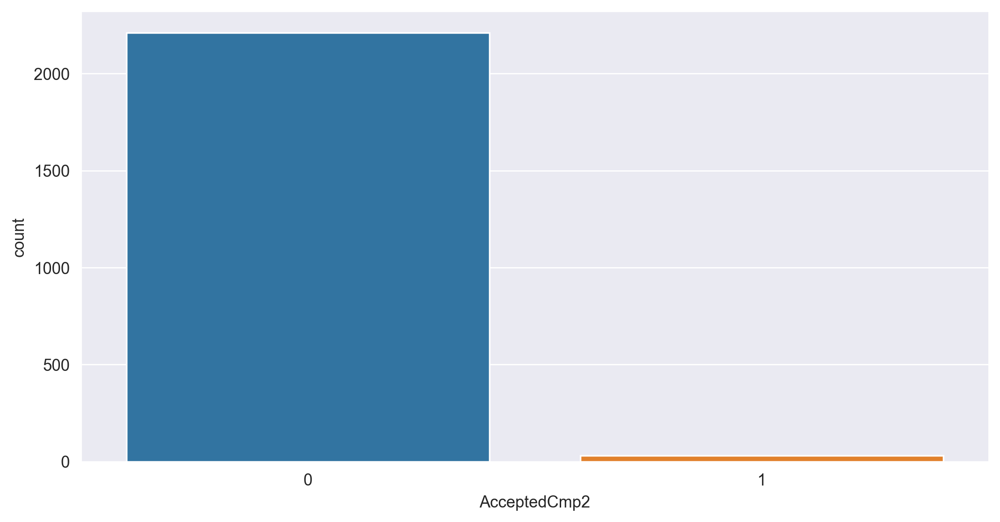

In [92]:
sns.countplot(x ='AcceptedCmp2', data =data)

In [93]:
data.head()

,ID,Age,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Children,Years_with_Company
0,5524,67,Graduation,Single,58138.0,58,635,81,546,120.5,81,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1,0,12.0
1,2174,70,Graduation,Single,46344.0,38,11,1,6,2.0,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0,2,10.0
2,4141,59,Graduation,Together,71613.0,26,426,49,127,111.0,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0,0,11.0
3,6182,40,Graduation,Together,26646.0,26,11,4,20,10.0,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0,1,10.0
4,5324,43,PhD,Married,58293.0,94,173,43,118,46.0,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0,1,10.0


#### 5.24 Univariate analysis on Complain column

In [94]:
data['Complain'].value_counts()

Complain
0    2219
1      21
Name: count, dtype: int64

<Axes: xlabel='Complain', ylabel='count'>

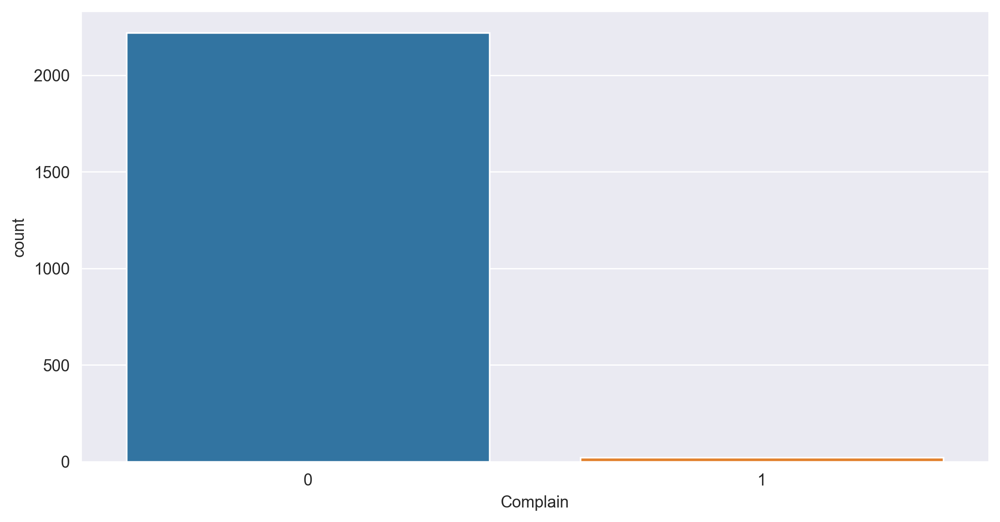

In [95]:
sns.countplot(x ='Complain', data =data)

#### 5.25 Univariate analysis on Z_CostContact column

In [96]:
data['Z_CostContact'].value_counts()

Z_CostContact
3    2240
Name: count, dtype: int64

- Dropping this column as this column have only one observation

In [97]:
data = data.drop(columns = ['Z_CostContact'])

#### 5.25 Univariate analysis on Z_Revenue column

In [98]:
data['Z_Revenue'].value_counts()

Z_Revenue
11    2240
Name: count, dtype: int64

- Dropping this column as this column have only one observation

In [99]:
data = data.drop(columns = ['Z_Revenue'])

#### 5.26 Univariate analysis on Response column

In [100]:
data['Response'].value_counts()

Response
0    1906
1     334
Name: count, dtype: int64

<Axes: xlabel='Response', ylabel='count'>

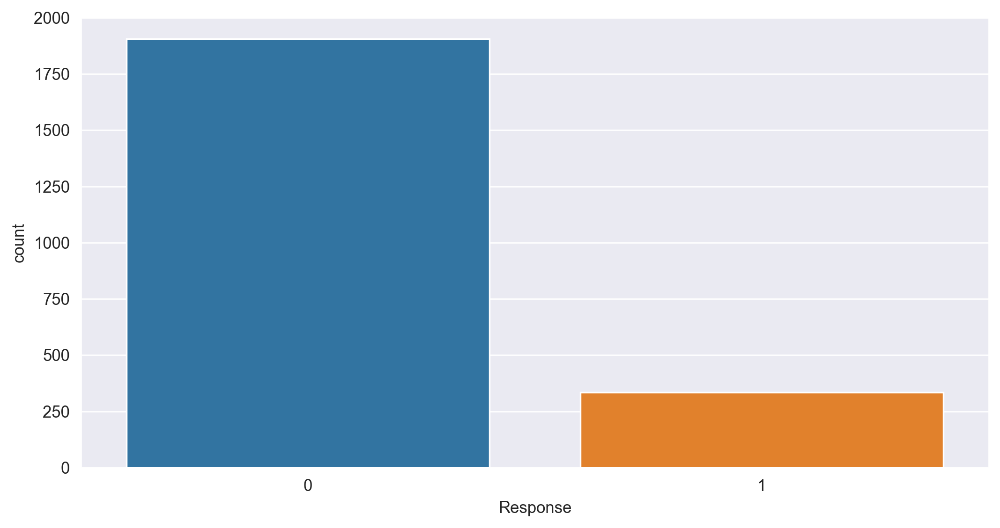

In [101]:
sns.countplot(x ='Response', data =data)

In [102]:
data.head()

,ID,Age,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Years_with_Company
0,5524,67,Graduation,Single,58138.0,58,635,81,546,120.5,81,88,3,8,10,4,7,0,0,0,0,0,0,1,0,12.0
1,2174,70,Graduation,Single,46344.0,38,11,1,6,2.0,1,6,2,1,1,2,5,0,0,0,0,0,0,0,2,10.0
2,4141,59,Graduation,Together,71613.0,26,426,49,127,111.0,21,42,1,8,2,10,4,0,0,0,0,0,0,0,0,11.0
3,6182,40,Graduation,Together,26646.0,26,11,4,20,10.0,3,5,2,2,0,4,6,0,0,0,0,0,0,0,1,10.0
4,5324,43,PhD,Married,58293.0,94,173,43,118,46.0,27,15,5,5,3,6,5,0,0,0,0,0,0,0,1,10.0


In [103]:
#Final shape of data after modifications
data.shape

(2240, 26)

In [104]:
data = data.drop(columns = ['ID'])

## 6. Feature engineering

### 6.1 Reducing the number of columns by merging related columns

In [105]:
data['Amount_Spent'] = data['MntWines'] + data['MntFruits'] + data['MntMeatProducts'] + data['MntFishProducts'] + data['MntSweetProducts'] + data['MntGoldProds']

In [106]:
data['Living_With'] = data['Marital_Status'].replace({'Married':'Partner', 'Together':'Partner', 'Absurd':'Alone', 'Widow':'Alone', 'YOLO':'Alone', 'Divorced':'Alone', 'Single':'Alone'})

In [107]:
data['Family_Size'] = data['Living_With'].replace({'Alone': 1, 'Partner':2}) + data['Children']

In [109]:
data['Education'] = data['Education'].replace({'Basic':'Undergraduate', '2n Cycle':'Undergraduate', 'Graduation':'Graduate', 'Master':'Postgraduate', 'PhD':'Postgraduate'})

In [110]:
data['Total_Purchases'] = data['NumWebPurchases'] + data['NumCatalogPurchases'] + data['NumStorePurchases'] + data['NumDealsPurchases']


In [111]:
data['TotalAcceptedCmp'] = data['AcceptedCmp1'] + data['AcceptedCmp2'] + data['AcceptedCmp3'] + data['AcceptedCmp4'] + data['AcceptedCmp5']

In [113]:
data['Education'].unique()

array(['Graduate', 'Postgraduate', 'Undergraduate'], dtype=object)

In [114]:
data['Education'] = data['Education'].map({'Undergraduate':0,'Graduate':1,'Postgraduate':2})
data['Living_With'] = data['Living_With'].map({'Alone':0,'Partner':1})

In [115]:
data.head()

,Age,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Years_with_Company,Amount_Spent,Living_With,Family_Size,Total_Purchases,TotalAcceptedCmp
0,67,1,Single,58138.0,58,635,81,546,120.5,81,88,3,8,10,4,7,0,0,0,0,0,0,1,0,12.0,1551.5,0,1,25,0
1,70,1,Single,46344.0,38,11,1,6,2.0,1,6,2,1,1,2,5,0,0,0,0,0,0,0,2,10.0,27.0,0,3,6,0
2,59,1,Together,71613.0,26,426,49,127,111.0,21,42,1,8,2,10,4,0,0,0,0,0,0,0,0,11.0,776.0,1,2,21,0
3,40,1,Together,26646.0,26,11,4,20,10.0,3,5,2,2,0,4,6,0,0,0,0,0,0,0,1,10.0,53.0,1,3,8,0
4,43,2,Married,58293.0,94,173,43,118,46.0,27,15,5,5,3,6,5,0,0,0,0,0,0,0,1,10.0,422.0,1,3,19,0


In [116]:
data=data.drop(columns=["Marital_Status","AcceptedCmp1" , "AcceptedCmp2", "AcceptedCmp3" , "AcceptedCmp4","AcceptedCmp5","NumWebVisitsMonth", "NumWebPurchases","NumCatalogPurchases","NumStorePurchases","NumDealsPurchases" ,"MntWines", "MntFruits", "MntMeatProducts", "MntFishProducts", "MntSweetProducts", "MntGoldProds"],axis=1)

In [117]:
data.head()

,Age,Education,Income,Recency,Complain,Response,Children,Years_with_Company,Amount_Spent,Living_With,Family_Size,Total_Purchases,TotalAcceptedCmp
0,67,1,58138.0,58,0,1,0,12.0,1551.5,0,1,25,0
1,70,1,46344.0,38,0,0,2,10.0,27.0,0,3,6,0
2,59,1,71613.0,26,0,0,0,11.0,776.0,1,2,21,0
3,40,1,26646.0,26,0,0,1,10.0,53.0,1,3,8,0
4,43,2,58293.0,94,0,0,1,10.0,422.0,1,3,19,0


### 7. Feature Scaling

In [121]:
# Converting the Data Into the Standard Format
sc = StandardScaler()
data_scaled = pd.DataFrame(sc.fit_transform(data), columns = data.columns)

In [122]:
data_scaled.head()

,Age,Education,Income,Recency,Complain,Response,Children,Years_with_Company,Amount_Spent,Living_With,Family_Size,Total_Purchases,TotalAcceptedCmp
0,1.007064,-0.410013,0.299208,0.307039,-0.097282,2.388846,-1.264505,1.861014,1.774839,-1.346874,-1.759115,1.380023,-0.439037
1,1.261969,-0.410013,-0.264251,-0.383664,-0.097282,-0.418612,1.396361,-1.208700,-0.989623,-1.346874,0.446548,-1.163336,-0.439037
2,0.327318,-0.410013,0.942978,-0.798086,-0.097282,-0.418612,-1.264505,0.326157,0.368581,0.742460,-0.656283,0.844579,-0.439037
3,-1.287080,-0.410013,-1.205325,-0.798086,-0.097282,-0.418612,0.065928,-1.208700,-0.942475,0.742460,0.446548,-0.895614,-0.439037
4,-1.032175,1.123256,0.306613,1.550305,-0.097282,-0.418612,0.065928,-1.208700,-0.273347,0.742460,0.446548,0.576857,-0.439037
